In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Instacart Dataset Tables

In [2]:
product = pd.read_csv('products.csv')
orders = pd.read_csv('orders.csv')
products_train = pd.read_csv('order_products__train.csv')
departments = pd.read_csv('departments.csv')
products_prior = pd.read_csv('order_products__prior.csv')
aisles = pd.read_csv('aisles.csv')

In [3]:
all_orders = pd.concat([products_train, products_prior], axis=0)
print("all_orders size is:", all_orders.shape)

all_orders size is: (33819106, 4)


In [4]:
product_count = product.shape
print('product count is:', product_count)

product count is: (49688, 4)


In [5]:
unique_users= len(set(orders.user_id))
print('user count is:', unique_users)

user count is: 206209


Data Frames

In [6]:
#order products train and prior contcatenation + size
all_product_orders = pd.concat([products_train, products_prior], axis=0)
print("all_product_orders size is:", all_product_orders.shape)

all_product_orders size is: (33819106, 4)


In [7]:
#products + aisles + departments
full_product_a = pd.merge(product, aisles, on='aisle_id')
full_product_ad = pd.merge(full_product_a, departments, on='department_id')

In [8]:
#orders dataframe
orders_df = pd.merge(all_product_orders, orders, on = 'order_id')

In [9]:
#complete dataframe
df = pd.merge(full_product_ad, orders_df, on = 'product_id')

In [10]:
df.head()

,product_id,product_name,aisle_id,department_id,aisle,department,order_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,6695,7,1,1540,train,29,1,1,8.0
1,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,48361,9,0,194636,train,5,2,14,11.0
2,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,63770,4,0,751,train,7,2,6,30.0
3,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,75339,9,0,142585,train,6,1,13,30.0
4,1,Chocolate Sandwich Cookies,61,19,cookies cakes,snacks,240996,3,1,57938,train,49,4,11,21.0


In [17]:
#all products count grouped by department
dp = df['product_name'].groupby(df['department']).value_counts()
dp

department       product_name                                                                                                                                                   
alcohol          Sauvignon Blanc                                                                                                                                                      8541
                 Cabernet Sauvignon                                                                                                                                                   6352
                 Chardonnay                                                                                                                                                           6346
                 Beer                                                                                                                                                                 6068
                 Vodka                                                     

In [16]:
pd.set_option('display.max_rows', None)

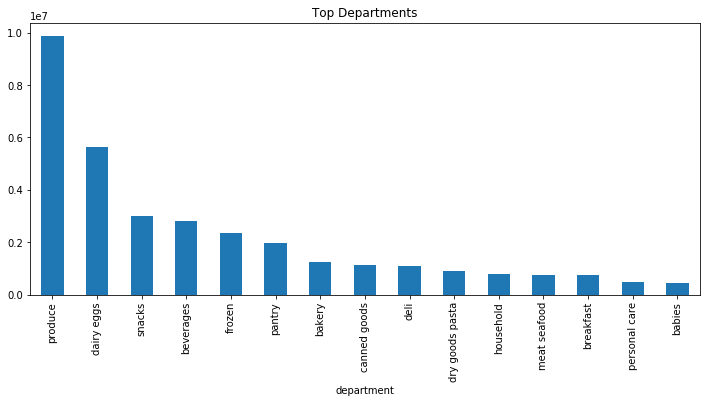

In [14]:
top_dept = 15
plt.figure(figsize=(12, 5))
df.groupby(['department']).count()['product_id']\
.sort_values(ascending=False)[:top_dept].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Departments')

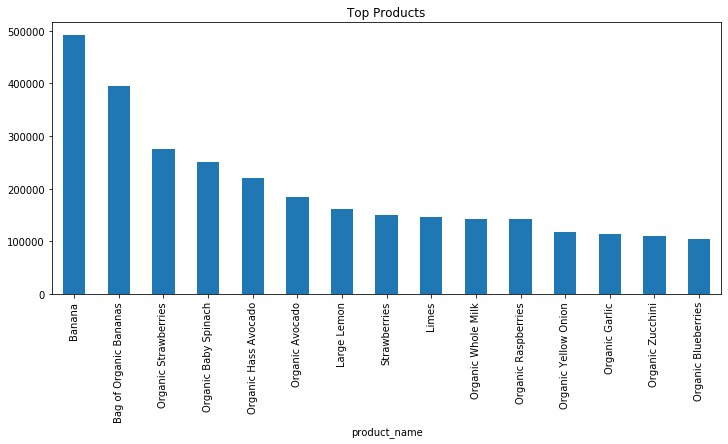

In [59]:
top_product = 15
plt.figure(figsize=(12, 5))
df.groupby(['product_name']).count()['product_id']\
.sort_values(ascending=False)[:top_product].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Products')

In [63]:
#top products with total reorders
grouped = df.groupby("product_id")["add_to_cart_order"].aggregate({'Total_reorders': 'sum'}).reset_index()
grouped = pd.merge(grouped, product[['product_id', 'product_name']], how='left', on=['product_id'])
grouped = grouped.sort_values(by='Total_reorders', ascending=False)[:10]
grouped

/Users/miguelgris/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: using a dict on a Series for aggregation
is deprecated and will be removed in a future version. Use                 named aggregation instead.

    >>> grouper.agg(name_1=func_1, name_2=func_2)

  


,product_id,Total_reorders,product_name
24849,24852,2405664,Banana
13173,13176,2007396,Bag of Organic Bananas
21134,21137,2005999,Organic Strawberries
21900,21903,1870623,Organic Baby Spinach
47205,47209,1497887,Organic Hass Avocado
47622,47626,1279007,Large Lemon
26206,26209,1261016,Limes
47762,47766,1187054,Organic Avocado
16794,16797,1065577,Strawberries
27963,27966,1031044,Organic Raspberries


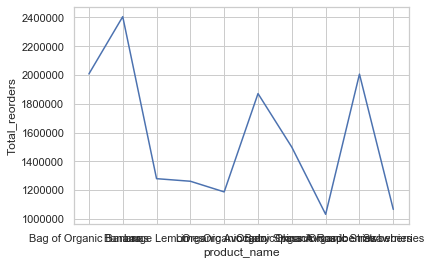

In [67]:
sns.set(style='whitegrid')
sns.lineplot(x='product_name', y='Total_reorders', data=grouped)

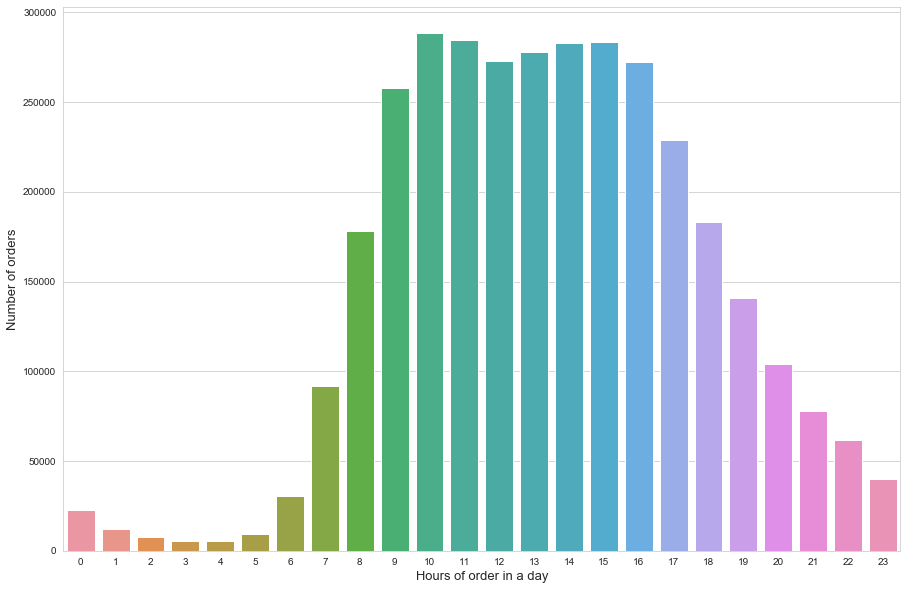

In [19]:
grouped = orders.groupby("order_id")["order_hour_of_day"].aggregate("sum").reset_index()
grouped = grouped.order_hour_of_day.value_counts()

sns.set_style("whitegrid")
f, ax = plt.subplots(figsize=(15, 10))
sns.barplot(grouped.index, grouped.values)
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Hours of order in a day', fontsize=13)
plt.show()

In [22]:
orders['order_dow'] = orders['order_dow'].map({0: 'Monday', 1: 'Tuesday', 2:'Wednesday', 3:'Thursday', 4:'Friday', 5:'Saturday', 6:'Sunday'})

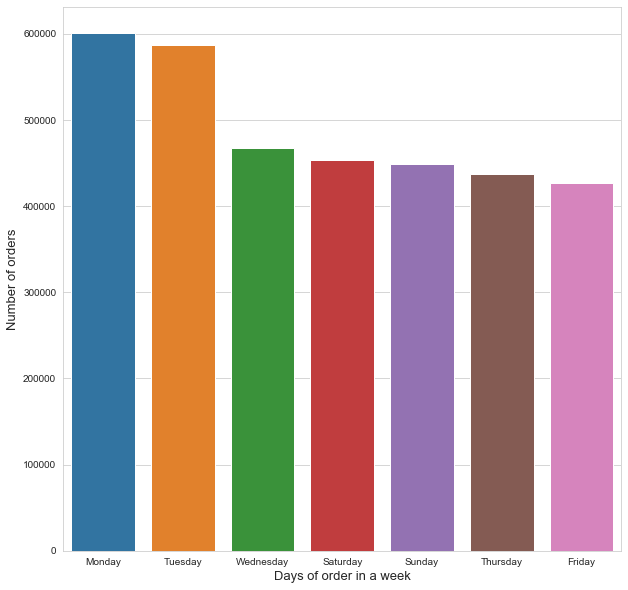

In [25]:
grouped = orders.groupby("order_id")["order_dow"].aggregate("sum").reset_index()
grouped = grouped.order_dow.value_counts()

f, ax = plt.subplots(figsize=(10, 10))
sns.barplot(grouped.index, grouped.values)
plt.ylabel('Number of orders', fontsize=13)
plt.xlabel('Days of order in a week', fontsize=13)
plt.show()

# User Classification Model

In [26]:
# csv from SQL
user_class = pd.read_csv('final_segmentation.csv')

In [27]:
#class dataframes
small_business = user_class[user_class['user_type']=='small business']
office = user_class[user_class['user_type']=='office']
active_c = user_class[user_class['user_type']=='active']
inactive_c = user_class[user_class['user_type']=='inactive']

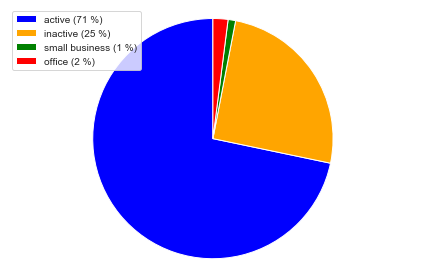

In [38]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = ['active (71 %)', 'inactive (25 %)', 
'small business (1 %)', 'office (2 %)']
sizes = [71, 25, 1, 2]
colors = ['blue', 'orange', 'green', 'red']
patches, texts = plt.pie(sizes, colors=colors, startangle=90)
plt.legend(patches, labels, loc="best")
# Set aspect ratio to be equal so that pie is drawn as a circle.
plt.axis('equal')
plt.tight_layout()
plt.show()

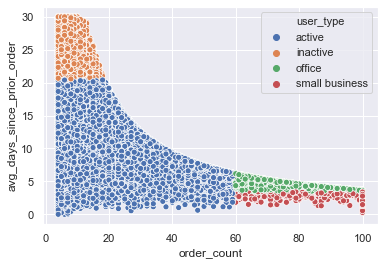

In [49]:
sns.scatterplot(x="order_count", y="avg_days_since_prior_order", hue="user_type",
...                      data=user_class)

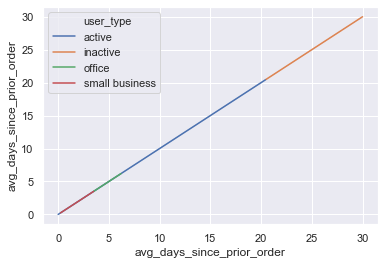

In [56]:
sns.lineplot(x="avg_days_since_prior_order", y="avg_days_since_prior_order", hue="user_type",
...                      data=user_class)

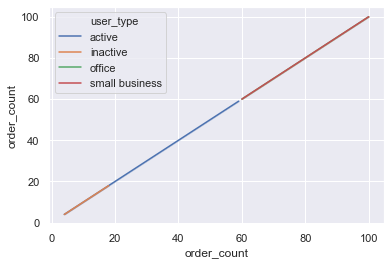

In [59]:
sns.lineplot(x="order_count", y="order_count", hue="user_type",
...                      data=user_class)

In [33]:
cf = pd.merge(user_class, df, on='user_id')

In [42]:
small_business = cf[cf['user_type']=='small business']
office = cf[cf['user_type']=='office']
active_c = cf[cf['user_type']=='active']
inactive_c = cf[cf['user_type']=='inactive']

In [43]:
smdp = small_business['product_name'].groupby(small_business['department']).value_counts()
smdp

department       product_name                                                                                                                                             
alcohol          Sauvignon Blanc                                                                                                                                                585
                 Chardonnay                                                                                                                                                     338
                 Vodka                                                                                                                                                          301
                 India Pale Ale                                                                                                                                                 287
                 Beer                                                                                        

In [47]:
odp = office['product_name'].groupby(office['department']).value_counts()
odp

department       product_name                                                                                                                                                   
alcohol          Chardonnay                                                                                                                                                           780
                 Vodka                                                                                                                                                                779
                 Sauvignon Blanc                                                                                                                                                      554
                 Cabernet Sauvignon                                                                                                                                                   549
                 Beer                                                          

In [46]:
acdp = active_c['product_name'].groupby(active_c['department']).value_counts()
acdp

department       product_name                                                                                                                                                   
alcohol          Sauvignon Blanc                                                                                                                                                      6605
                 Cabernet Sauvignon                                                                                                                                                   4997
                 Beer                                                                                                                                                                 4777
                 Chardonnay                                                                                                                                                           4736
                 Vodka                                                     

In [48]:
icdp = inactive_c['product_name'].groupby(inactive_c['department']).value_counts()
icdp

department       product_name                                                                                                                                                   
alcohol          Sauvignon Blanc                                                                                                                                                      797
                 Cabernet Sauvignon                                                                                                                                                   686
                 Chardonnay                                                                                                                                                           492
                 Beer                                                                                                                                                                 491
                 Pinot Noir                                                    

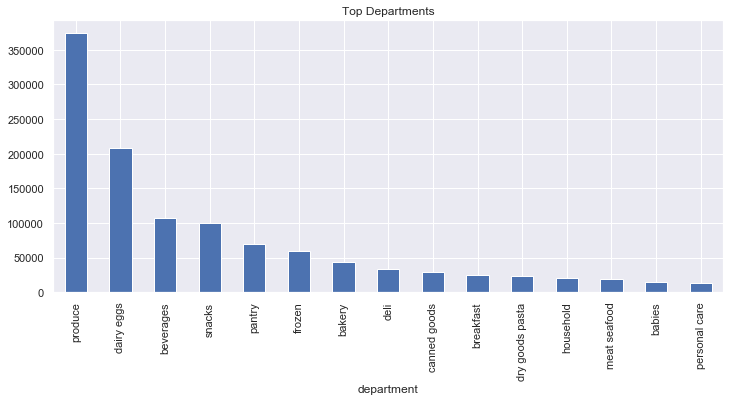

In [60]:
top_dept = 15
plt.figure(figsize=(12, 5))
small_business.groupby(['department']).count()['product_id']\
.sort_values(ascending=False)[:top_dept].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Departments')

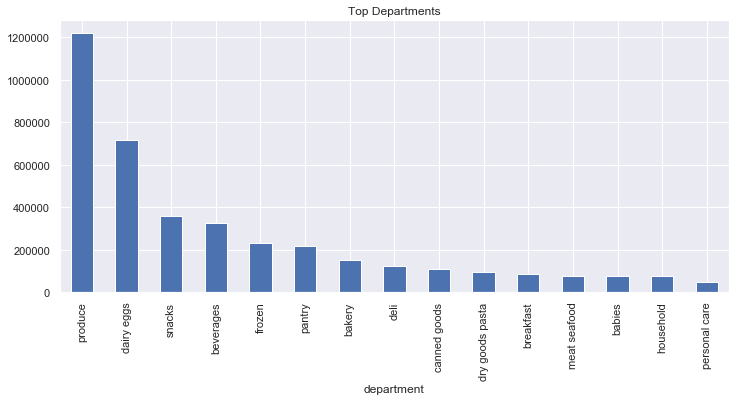

In [61]:
top_dept = 15
plt.figure(figsize=(12, 5))
office.groupby(['department']).count()['product_id']\
.sort_values(ascending=False)[:top_dept].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Departments')

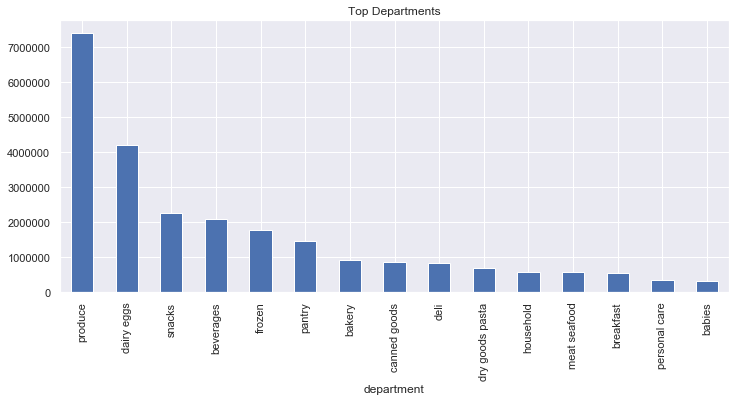

In [62]:
top_dept = 15
plt.figure(figsize=(12, 5))
active_c.groupby(['department']).count()['product_id']\
.sort_values(ascending=False)[:top_dept].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Departments')

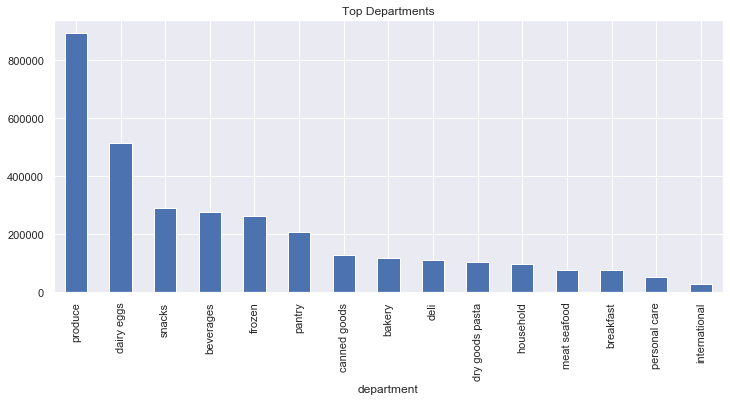

In [63]:
top_dept = 15
plt.figure(figsize=(12, 5))
inactive_c.groupby(['department']).count()['product_id']\
.sort_values(ascending=False)[:top_dept].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Departments')

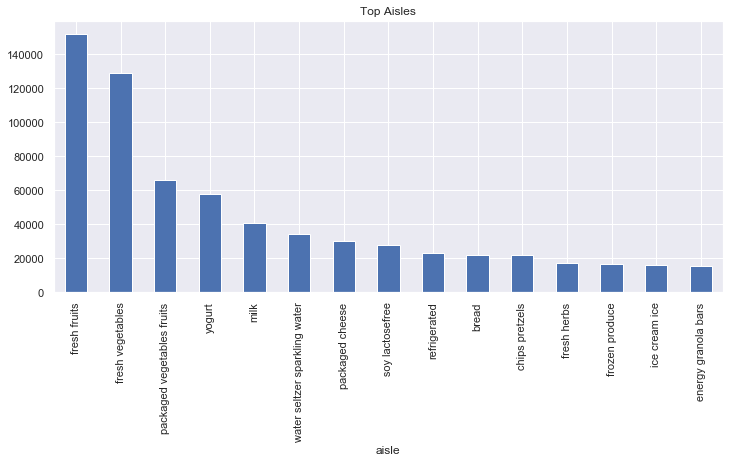

In [64]:
top_aisle = 15
plt.figure(figsize=(12, 5))
small_business.groupby(['aisle']).count()['product_id']\
.sort_values(ascending=False)[:top_aisle].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Aisles')

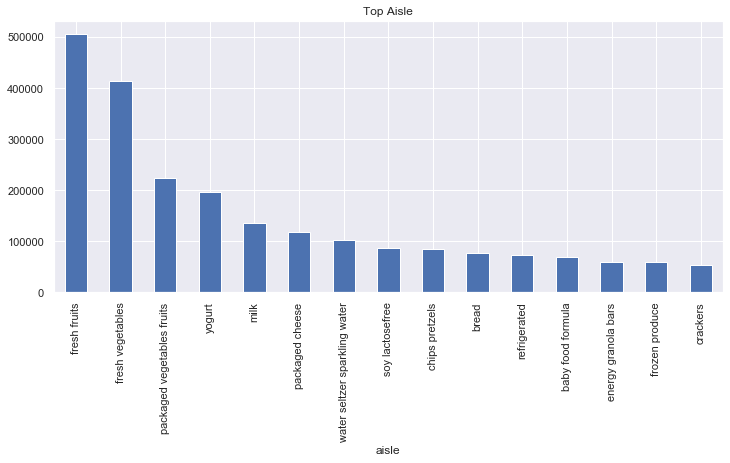

In [65]:
top_aisle = 15
plt.figure(figsize=(12, 5))
office.groupby(['aisle']).count()['product_id']\
.sort_values(ascending=False)[:top_aisle].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Aisle')

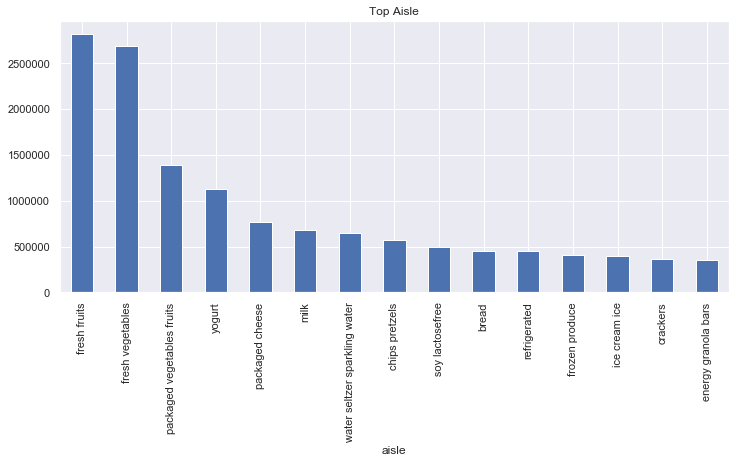

In [67]:
top_aisle = 15
plt.figure(figsize=(12, 5))
active_c.groupby(['aisle']).count()['product_id']\
.sort_values(ascending=False)[:top_aisle].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Aisle')

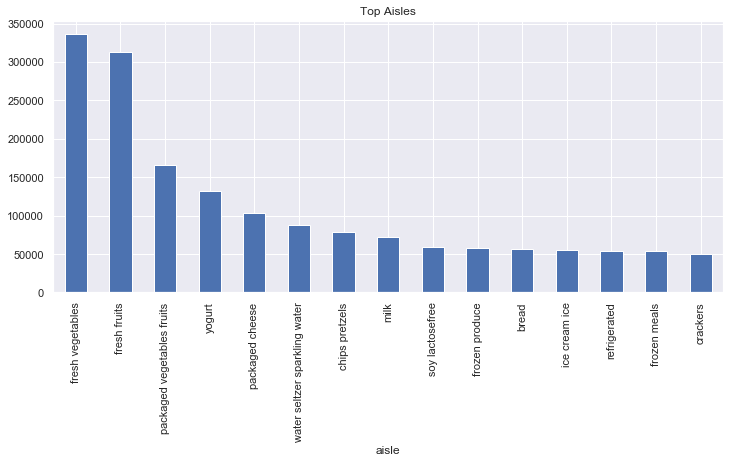

In [66]:
top_aisle = 15
plt.figure(figsize=(12, 5))
inactive_c.groupby(['aisle']).count()['product_id']\
.sort_values(ascending=False)[:top_aisle].plot(kind='bar', 
                                   #figsize=(12, 5), 
                                   title='Top Aisles')

In [ ]:
ax = sns.stripplot(x="order_dow", y="order_count", data=cf,
...                    jitter=True)